In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [113]:
df = pd.read_csv('data/train_transaction.csv')

In [4]:
df.describe()

,TransactionID,isFraud,TransactionDT,TransactionAmt,card1,card2,card3,card5,addr1,addr2,...,V330,V331,V332,V333,V334,V335,V336,V337,V338,V339
count,5.905400e+05,590540.000000,5.905400e+05,590540.000000,590540.000000,581607.000000,588975.000000,586281.000000,524834.000000,524834.000000,...,82351.000000,82351.000000,82351.000000,82351.000000,82351.000000,82351.00000,82351.000000,82351.000000,82351.000000,82351.000000
mean,3.282270e+06,0.034990,7.372311e+06,135.027176,9898.734658,362.555488,153.194925,199.278897,290.733794,86.800630,...,0.775874,721.741883,1375.783644,1014.622782,9.807015,59.16455,28.530903,55.352422,151.160542,100.700882
std,1.704744e+05,0.183755,4.617224e+06,239.162522,4901.170153,157.793246,11.336444,41.244453,101.741072,2.690623,...,4.727971,6217.223583,11169.275702,7955.735482,243.861391,387.62948,274.576920,668.486833,1095.034387,814.946722
min,2.987000e+06,0.000000,8.640000e+04,0.251000,1000.000000,100.000000,100.000000,100.000000,100.000000,10.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000
25%,3.134635e+06,0.000000,3.027058e+06,43.321000,6019.000000,214.000000,150.000000,166.000000,204.000000,87.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000
50%,3.282270e+06,0.000000,7.306528e+06,68.769000,9678.000000,361.000000,150.000000,226.000000,299.000000,87.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000
75%,3.429904e+06,0.000000,1.124662e+07,125.000000,14184.000000,512.000000,150.000000,226.000000,330.000000,87.000000,...,0.000000,0.000000,25.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000
max,3.577539e+06,1.000000,1.581113e+07,31937.391000,18396.000000,600.000000,231.000000,237.000000,540.000000,102.000000,...,55.000000,160000.000000,160000.000000,160000.000000,55125.000000,55125.00000,55125.000000,104060.000000,104060.000000,104060.000000


In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 250893 entries, 0 to 250892
Columns: 394 entries, TransactionID to V339
dtypes: float64(376), int64(4), object(14)
memory usage: 754.2+ MB


In [25]:
df.dtypes

TransactionID       int64
isFraud             int64
TransactionDT       int64
TransactionAmt    float64
ProductCD          object
                   ...   
V335              float64
V336              float64
V337              float64
V338              float64
V339              float64
Length: 394, dtype: object

## Handling missing values

In [43]:
# Check missing values
missing_values = df.isnull().sum() / len(df) * 100
print(missing_values[missing_values > 0])

dropped_cols = []

# delete columns with more than 50% of missing values
for col in df.columns:
    if df[col].isnull().mean() > 0.5:
        dropped_cols.append(col)
        df.drop(col, axis=1, inplace=True)

print('Cols that were dropped', dropped_cols)

card2     1.652497
card3     0.001196
card4     0.003986
card5     0.542064
card6     0.002790
           ...    
V335     78.787372
V336     78.787372
V337     78.787372
V338     78.787372
V339     78.787372
Length: 331, dtype: float64
Cols that were dropped ['dist1', 'dist2', 'R_emaildomain', 'D2', 'D3', 'D5', 'D6', 'D7', 'D8', 'D9', 'D11', 'D12', 'D13', 'D14', 'M1', 'M2', 'M3', 'M4', 'M5', 'M7', 'M8', 'M9', 'V1', 'V2', 'V3', 'V4', 'V5', 'V6', 'V7', 'V8', 'V9', 'V10', 'V11', 'V138', 'V139', 'V140', 'V141', 'V142', 'V143', 'V144', 'V145', 'V146', 'V147', 'V148', 'V149', 'V150', 'V151', 'V152', 'V153', 'V154', 'V155', 'V156', 'V157', 'V158', 'V159', 'V160', 'V161', 'V162', 'V163', 'V164', 'V165', 'V166', 'V167', 'V168', 'V169', 'V170', 'V171', 'V172', 'V173', 'V174', 'V175', 'V176', 'V177', 'V178', 'V179', 'V180', 'V181', 'V182', 'V183', 'V184', 'V185', 'V186', 'V187', 'V188', 'V189', 'V190', 'V191', 'V192', 'V193', 'V194', 'V195', 'V196', 'V197', 'V198', 'V199', 'V200', 'V201', 'V202'

## Filling null values

In [55]:
# Get a list of columns with null values afer removing features with > 50% missing values
null_columns = df.columns[df.isnull().any()].tolist()
print(null_columns)
df.isnull().sum()

['card2', 'card3', 'card4', 'card5', 'card6', 'addr1', 'addr2', 'P_emaildomain', 'D1', 'D4', 'D10', 'D15', 'M6', 'V12', 'V13', 'V14', 'V15', 'V16', 'V17', 'V18', 'V19', 'V20', 'V21', 'V22', 'V23', 'V24', 'V25', 'V26', 'V27', 'V28', 'V29', 'V30', 'V31', 'V32', 'V33', 'V34', 'V35', 'V36', 'V37', 'V38', 'V39', 'V40', 'V41', 'V42', 'V43', 'V44', 'V45', 'V46', 'V47', 'V48', 'V49', 'V50', 'V51', 'V52', 'V53', 'V54', 'V55', 'V56', 'V57', 'V58', 'V59', 'V60', 'V61', 'V62', 'V63', 'V64', 'V65', 'V66', 'V67', 'V68', 'V69', 'V70', 'V71', 'V72', 'V73', 'V74', 'V75', 'V76', 'V77', 'V78', 'V79', 'V80', 'V81', 'V82', 'V83', 'V84', 'V85', 'V86', 'V87', 'V88', 'V89', 'V90', 'V91', 'V92', 'V93', 'V94', 'V279', 'V280', 'V281', 'V282', 'V283', 'V284', 'V285', 'V286', 'V287', 'V288', 'V289', 'V290', 'V291', 'V292', 'V293', 'V294', 'V295', 'V296', 'V297', 'V298', 'V299', 'V300', 'V301', 'V302', 'V303', 'V304', 'V305', 'V306', 'V307', 'V308', 'V309', 'V310', 'V311', 'V312', 'V313', 'V314', 'V315', 'V316', 'V

isFraud            0
TransactionDT      0
TransactionAmt     0
ProductCD          0
card1              0
                  ..
V317              11
V318              11
V319              11
V320              11
V321              11
Length: 201, dtype: int64

In [46]:
# drop the transaction ID

df.drop('TransactionID', axis=1, inplace=True)

In [ ]:
import matplotlib.pyplot as plt

for col in null_columns:
    plt.figure(figsize=(10, 6))
    df[col].hist(bins=30, edgecolor='black')
    plt.title('Distribution of column_name')
    plt.xlabel('column_name')
    plt.ylabel('Frequency')
    plt.show()


I plotted the distribution of columns with null values to know what approach to take in fill null values.
Almost all of them did not have a normal distribution. Most had a majority of values tilted towards one value, so it made sense to fill null values with mode, instead of mean or median. This approach is also safe for categorical features.

In [60]:
# fill null values with mode
for col in df.columns:
    df[col].fillna(df[col].mode()[0], inplace=True)

C:\Users\X1 Carbon G6\AppData\Local\Temp\ipykernel_19128\843442352.py:3: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df[col].fillna(df[col].mode()[0], inplace=True)
C:\Users\X1 Carbon G6\AppData\Local\Temp\ipykernel_19128\843442352.py:3: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a cop

## Handling categorical features

In [63]:
# get categorical features
categorical_columns = df.select_dtypes(include=['object', 'category']).columns

print("Categorical Columns:", categorical_columns)

# Get number of unique categories in each categorical column
unique_counts = df[categorical_columns].nunique()

print("Number of unique categories in each categorical column:")
print(unique_counts)

Categorical Columns: Index(['ProductCD', 'card4', 'card6', 'P_emaildomain', 'M6'], dtype='object')
Number of unique categories in each categorical column:
ProductCD         5
card4             4
card6             4
P_emaildomain    59
M6                2
dtype: int64


In [64]:
# Select categorical columns with unique values <= 5
low_cardinality_cols = [col for col in categorical_columns if df[col].nunique() <= 5]

# Display the result
print("Categorical columns with 5 or fewer unique values:", low_cardinality_cols)


Categorical columns with 5 or fewer unique values: ['ProductCD', 'card4', 'card6', 'M6']


In [65]:
# One-hot encoding for low-cardinality features
df_one_hot = pd.get_dummies(df, columns=low_cardinality_cols, drop_first=True)

In [71]:
# check for the remaining categorical features
categorical_columns = df_one_hot.select_dtypes(include=['object', 'category']).columns
print(categorical_columns)

Index(['P_emaildomain'], dtype='object')


The only remaining categorical feature is P_emaildomain with 59 unique counts.
This feature is the purchase email domain and seem useful. I will use frequency encoding for this feature.

In [74]:
freq_encoding = df_one_hot['P_emaildomain'].value_counts()/len(df_one_hot)
df_one_hot['P_emaildomain_freq_encoded'] = df['P_emaildomain'].map(freq_encoding)

In [81]:
df_one_hot['P_emaildomain_freq_encoded'].head()

# Drop original column after encoding
df_one_hot.drop('P_emaildomain', axis=1, inplace=True)

In [83]:
# Check for missing values
missing_values = df_one_hot.isnull().sum()

#### No more missing values

### Correlation Analysis

In [84]:
df_one_hot.corr()

,isFraud,TransactionDT,TransactionAmt,card1,card2,card3,card5,addr1,addr2,C1,...,ProductCD_S,ProductCD_W,card4_discover,card4_mastercard,card4_visa,card6_credit,card6_debit,card6_debit or credit,M6_T,P_emaildomain_freq_encoded
isFraud,1.000000,0.039878,0.003787,-0.018333,0.002983,0.143642,-0.042620,-0.000415,-0.031610,0.034887,...,0.009611,-0.101288,0.004353,0.008542,-0.006622,0.085937,-0.085886,-0.001418,-0.060547,0.029080
TransactionDT,0.039878,1.000000,0.017341,-0.003851,-0.024543,-0.011890,0.007881,-0.003156,0.097860,-0.059454,...,-0.029736,0.206910,-0.012352,0.021344,0.001763,-0.097846,0.097840,-0.000448,0.093898,0.028085
TransactionAmt,0.003787,0.017341,1.000000,-0.005129,0.013175,-0.113548,0.000624,-0.012778,0.033864,-0.023689,...,-0.049466,0.129341,0.052055,-0.008652,-0.014309,0.137266,-0.137188,-0.001121,0.109677,-0.041851
card1,-0.018333,-0.003851,-0.005129,1.000000,0.003350,0.003532,-0.090494,0.016725,-0.001748,0.009526,...,-0.013070,0.007666,-0.123167,-0.005075,0.036541,-0.024759,0.024946,-0.009510,0.005192,-0.002915
card2,0.002983,-0.024543,0.013175,0.003350,1.000000,0.027787,0.022766,0.031174,-0.023652,0.009636,...,0.012484,-0.116547,-0.026296,-0.065990,0.057741,0.150325,-0.150339,0.009302,-0.023944,-0.047105
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
card6_credit,0.085937,-0.097846,0.137266,-0.024759,0.150325,0.036141,-0.173795,0.005187,-0.030250,0.008230,...,0.073703,-0.377061,0.159760,0.015305,-0.120634,1.000000,-0.999751,-0.005002,-0.096311,-0.141857
card6_debit,-0.085886,0.097840,-0.137188,0.024946,-0.150339,-0.036039,0.173989,-0.005023,0.030685,-0.008209,...,-0.073664,0.377068,-0.159718,-0.015436,0.120734,-0.999751,1.000000,-0.011950,0.096334,0.141839
card6_debit or credit,-0.001418,-0.000448,-0.001121,-0.009510,0.009302,-0.002195,-0.016079,-0.010893,0.000688,-0.000642,...,-0.001080,0.005415,-0.000875,0.011589,-0.010724,-0.005002,-0.011950,1.000000,0.001731,0.007053
M6_T,-0.060547,0.093898,0.109677,0.005192,-0.023944,-0.184781,0.082291,-0.028487,0.057930,-0.037321,...,-0.090952,0.455888,0.004914,-0.004083,0.032120,-0.096311,0.096334,0.001731,1.000000,-0.004204


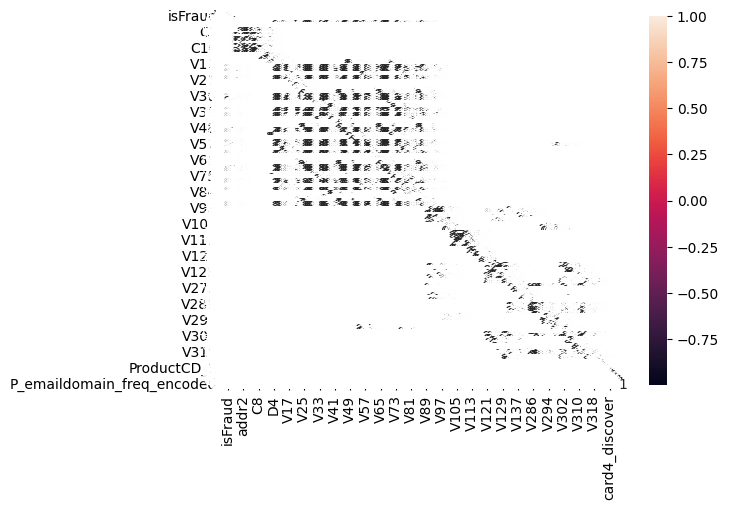

In [85]:
import seaborn as sns

df_one_hot_corr = df_one_hot.corr()

sns.heatmap(df_one_hot_corr, annot=True)
plt.rcParams['figure.figsize'] = (10, 7)
plt.show()

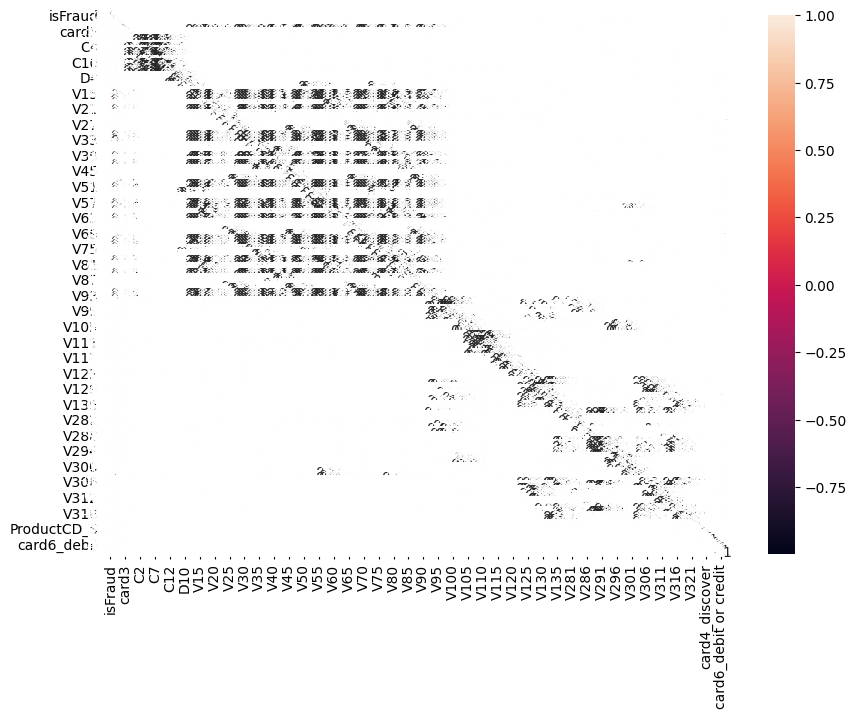

In [86]:
sns.heatmap(df_one_hot_corr, annot=True)
plt.rcParams['figure.figsize'] = (50, 50)
plt.show()

In [87]:
len(df_one_hot_corr)

208

#### from the graph above, the correlation is high between the variables, and removing features now won't be a first step

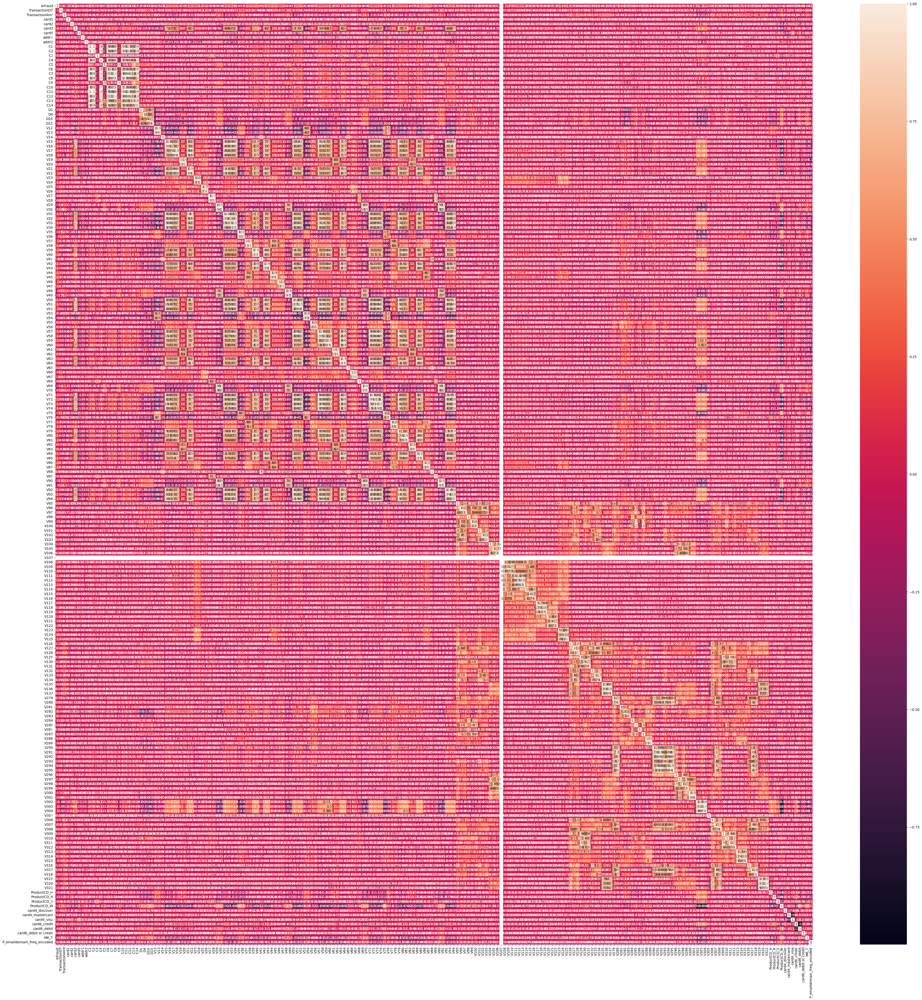

In [88]:
sns.heatmap(df_one_hot_corr, annot=True)
plt.rcParams['figure.figsize'] = (208, 208)
plt.show()

Examine feature with high correlation

In [96]:
# Calculate the correlation matrix
correlation_matrix = df_one_hot.corr()

# Set the threshold for high correlation
correlation_threshold = 0.9

# Create a mask to identify highly correlated pairs (excluding the diagonal)
mask = np.triu(np.ones_like(correlation_matrix, dtype=bool))
high_corr_pairs = correlation_matrix.where(~mask).stack().reset_index()
high_corr_pairs.columns = ['Column1', 'Column2', 'Correlation']

# Filter for pairs with correlation above the threshold
high_corr_pairs = high_corr_pairs[high_corr_pairs['Correlation'].abs() > correlation_threshold]

# Display highly correlated column pairs
if not high_corr_pairs.empty:
    print("Highly correlated column pairs (correlation > 0.9):")
    print(high_corr_pairs)
else:
    print("No highly correlated column pairs found.")

# Suggest columns to drop based on correlation
columns_to_drop = set()
for col1, col2, corr in high_corr_pairs.itertuples(index=False):
    # Drop one of the highly correlated columns
    columns_to_drop.add(col2)

print("\nColumns that can be considered for removal:")
print(columns_to_drop)


Highly correlated column pairs (correlation > 0.9):
           Column1           Column2  Correlation
54              C2                C1     0.996163
75              C4                C1     0.982077
76              C4                C2     0.985116
100             C6                C1     0.987883
101             C6                C2     0.984711
...            ...               ...          ...
18913         V321              V319     0.972702
18914         V321              V320     0.949839
19678  ProductCD_W              V302    -0.903928
20300   card4_visa  card4_mastercard    -0.925367
20705  card6_debit      card6_credit    -0.999751

[177 rows x 3 columns]

Columns that can be considered for removal:
{'V307', 'C5', 'V44', 'C11', 'V12', 'C8', 'V60', 'V74', 'V313', 'V52', 'V51', 'V72', 'V302', 'V131', 'V69', 'C10', 'C2', 'V21', 'V48', 'V59', 'C4', 'V53', 'V63', 'V50', 'V136', 'card4_mastercard', 'V18', 'V303', 'V84', 'V34', 'V309', 'V37', 'V42', 'V80', 'V112', 'V79', 'C6', 'V7

In [98]:
# Remove one feature from feature-pair with high correlation (69 of them)
df_dropped = df_one_hot.drop(columns=columns_to_drop)
print(f"New shape after dropping columns: {df_dropped.shape}")

New shape after dropping columns: (250893, 139)


### Develop features like transaction velocity, time patterns (e.g., hour of the day, day of the week), and rolling window statistics.

This process was not performed as most of the features were already removed. I just did analysis to see the transaction sequence.

In [117]:
print(df_dropped['D1'].describe())
print(df_dropped['D10'].describe())

count    250893.000000
mean         83.637838
std         144.911472
min           0.000000
25%           0.000000
50%           0.000000
75%         102.000000
max         639.000000
Name: D1, dtype: float64
count    250893.000000
mean         92.913429
std         157.972937
min           0.000000
25%           0.000000
50%           0.000000
75%         120.000000
max         763.000000
Name: D10, dtype: float64


In [115]:
timedelta_cols = ['TransactionDT'] + [f'D{i}' for i in range(1, 16)]
print(timedelta_cols)
print(df['D1'].dtype)
print(df[['TransactionDT', 'D1', 'D2', 'D3', 'D4', 'D5', 'D6', 'D7', 'D8', 'D9', 'D10', 'D11', 'D12', 'D13', 'D14', 'D15']])

['TransactionDT', 'D1', 'D2', 'D3', 'D4', 'D5', 'D6', 'D7', 'D8', 'D9', 'D10', 'D11', 'D12', 'D13', 'D14', 'D15']
float64
        TransactionDT     D1     D2    D3     D4     D5   D6  D7        D8  \
0               86400   14.0    NaN  13.0    NaN    NaN  NaN NaN       NaN   
1               86401    0.0    NaN   NaN    0.0    NaN  NaN NaN       NaN   
2               86469    0.0    NaN   NaN    0.0    NaN  NaN NaN       NaN   
3               86499  112.0  112.0   0.0   94.0    0.0  NaN NaN       NaN   
4               86506    0.0    NaN   NaN    NaN    NaN  NaN NaN       NaN   
...               ...    ...    ...   ...    ...    ...  ...  ..       ...   
250888        5971512    0.0    NaN   NaN  472.0    0.0  NaN NaN       NaN   
250889        5971537    0.0    NaN   NaN    NaN    NaN  NaN NaN  0.083333   
250890        5971559   13.0    5.0   3.0    3.0    3.0  NaN NaN       NaN   
250891        5971576    0.0    NaN   NaN    0.0    NaN  0.0 NaN       NaN   
250892        597158

Steps to create transaction velocity features
1. Convert TransactionDT time delta from seconds to days to align with D1 to D15.
2. The cumulative sum of D1 to D15 helps capture the sequential nature of the transactions.
3. The velocity is the ratio of the transaction time (TransactionDT_days) to the cumulative days up to each transaction point (D1 to D15).
4. Replacing infinite and NaN values to ensure smooth computation.

In [ ]:
import pandas as pd
import numpy as np

# Convert TransactionDT to days
df['TransactionDT_days'] = df['TransactionDT'] / 86400

# Calculate cumulative days from D1 to D15
df['cumulative_days'] = df[[f'D{i}' for i in range(1, 16)]].cumsum(axis=1)

# Calculate transaction velocity for each D1-D15
for i in range(1, 16):
    velocity_col = f'transaction_velocity_D{i}'

    df[velocity_col] = df['TransactionDT_days'] / df['cumulative_days'][f'D{i}']

# Replace inf and NaN values with 0 (handle missing or zero divisions)
df.replace([np.inf, -np.inf], 0, inplace=True)
df.fillna(0, inplace=True)

df[[f'transaction_velocity_D{i}' for i in range(1, 16)]].head()


## Identifying low importance features using random forest.

In [118]:
# Identifying Important features using random forest
from sklearn.ensemble import RandomForestClassifier

# Prepare data for feature importance
X = df_dropped.drop('isFraud', axis=1)
y = df_dropped['isFraud']

# Train a random forest model
model = RandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X, y)

# Get feature importances
feature_importances = pd.Series(model.feature_importances_, index=X.columns).sort_values(ascending=False)
print("Top 20 important features:")
print(feature_importances.head(20))


Top 20 important features:
TransactionDT                 0.089537
TransactionAmt                0.062704
card1                         0.058458
card2                         0.044134
addr1                         0.040305
C14                           0.037659
C12                           0.032796
P_emaildomain_freq_encoded    0.030632
V45                           0.028769
card5                         0.024149
V87                           0.021052
D15                           0.018110
D1                            0.016319
D4                            0.016293
V86                           0.013157
D10                           0.012776
V310                          0.011697
V308                          0.011631
V317                          0.011256
card6_debit                   0.010291
dtype: float64


In [119]:
feature_importances.tail(20)

V110                     7.916268e-04
V114                     5.739471e-04
V116                     5.700608e-04
C3                       3.125680e-04
V121                     1.700969e-04
V118                     1.202097e-04
V122                     1.054506e-04
V120                     1.026637e-04
V119                     9.299475e-05
V117                     8.644736e-05
V41                      1.548535e-05
V14                      1.026604e-05
V28                      9.518247e-06
V88                      7.273750e-06
V68                      5.092665e-06
V89                      2.270410e-06
V65                      1.876531e-06
card6_debit or credit    8.459211e-07
V107                     0.000000e+00
V305                     0.000000e+00
dtype: float64

### Training an XGBoost model

In [120]:
import xgboost as xgb
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, roc_auc_score, classification_report


# Split data into training and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Create the DMatrix data structure for XGBoost, which optimizes memory usage
dtrain = xgb.DMatrix(X_train, label=y_train)
dtest = xgb.DMatrix(X_test, label=y_test)

# Define parameters for the XGBoost model
params = {
    'objective': 'binary:logistic',  # for binary classification
    'max_depth': 6,                 # depth of each tree
    'eta': 0.1,                     # learning rate
    'subsample': 0.8,               # fraction of data to be used for each tree
    'colsample_bytree': 0.8,        # fraction of features used per tree
    'eval_metric': 'auc'            # metric for evaluation
}

# Train the model
xgb_model = xgb.train(params, dtrain, num_boost_round=100, evals=[(dtest, 'test')], early_stopping_rounds=10)

# Make predictions on the test set
y_pred_prob = xgb_model.predict(dtest)
y_pred = [1 if prob > 0.5 else 0 for prob in y_pred_prob]  # Convert probabilities to binary output

# Evaluate the model
accuracy = accuracy_score(y_test, y_pred)
roc_auc = roc_auc_score(y_test, y_pred_prob)
print("Accuracy:", accuracy)
print("ROC AUC:", roc_auc)
print("Classification Report:\n", classification_report(y_test, y_pred))

# Optional: Feature importance plot
xgb.plot_importance(xgb_model)


[0]	test-auc:0.78757
[1]	test-auc:0.82214
[2]	test-auc:0.82589
[3]	test-auc:0.83080
[4]	test-auc:0.84046
[5]	test-auc:0.85099
[6]	test-auc:0.85160
[7]	test-auc:0.85212
[8]	test-auc:0.85314
[9]	test-auc:0.85817
[10]	test-auc:0.85851
[11]	test-auc:0.85936
[12]	test-auc:0.86060
[13]	test-auc:0.86175
[14]	test-auc:0.86297
[15]	test-auc:0.86467
[16]	test-auc:0.86616
[17]	test-auc:0.86622
[18]	test-auc:0.86773
[19]	test-auc:0.86923
[20]	test-auc:0.87177
[21]	test-auc:0.87171
[22]	test-auc:0.87277
[23]	test-auc:0.87486
[24]	test-auc:0.87641
[25]	test-auc:0.87747
[26]	test-auc:0.87942
[27]	test-auc:0.88010
[28]	test-auc:0.88047
[29]	test-auc:0.88111
[30]	test-auc:0.88226
[31]	test-auc:0.88350
[32]	test-auc:0.88417
[33]	test-auc:0.88524
[34]	test-auc:0.88535
[35]	test-auc:0.88622
[36]	test-auc:0.88699
[37]	test-auc:0.88883
[38]	test-auc:0.89063
[39]	test-auc:0.89127
[40]	test-auc:0.89205
[41]	test-auc:0.89364
[42]	test-auc:0.89387
[43]	test-auc:0.89408
[44]	test-auc:0.89514
[45]	test-auc:0.8959

<Axes: title={'center': 'Feature importance'}, xlabel='F score', ylabel='Features'>

In [124]:
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.98      1.00      0.99     48540
           1       0.90      0.39      0.54      1639

    accuracy                           0.98     50179
   macro avg       0.94      0.69      0.77     50179
weighted avg       0.98      0.98      0.97     50179



In [125]:
import pickle

# Save the trained model to a file
with open("xgb_model.pkl", "wb") as model_file:
    pickle.dump(xgb_model, model_file)


## Using the model for inference